In [1]:
__author__ = 'Kunwanhui Niu <niukwh@uchicago.edu>' # single string; emails in <>
__version__ = '20230524' # yyyymmdd; version datestamp of this notebook
__datasets__ = ['DES Y3 Gold, LS DR10 Tractor']  # datasets used in this notebook
__keywords__ = ['cluster, extragalactic, Healpix map, image cutout, joint query'] # keywords relevant to this notebook, e.g. ['science case','dwarf galaxies'] Use only keywords from the master list: https://github.com/astro-datalab/notebooks-latest/blob/master/keywords.txt

# Simple Cluster Finder Using Healpix

*Kunwanhui Niu, University of Chicago*

### Table of contents
* [Goals & notebook summary](#goals)
* [Disclaimer & Attribution](#attribution)
* [Imports & setup](#import)
* [Running on DES](#des1)
* [Running on LS](#ls1)
* [Comparison](#comp)
* [Resources and references](#resources)

<a class="anchor" id="goals"></a>
# Goals
This notebook is aimed to quickly find overdensities in galaxy distribution (galaxy clusters) using healpix in either DES Y3 Gold or LS DR10 Tractor catalogs.

# Summary
We obtain *grz* photometric data and photo-z results of extended sources in a cutout of either DES Y3 Gold or LS DR10 Tractor catalog, bin on redshift and filter red galaxies, calculate richness in a healpix map with convolution, and attempt to acquire image cutouts centered on the brightest selected galaxy in each rich field.

<a class="anchor" id="attribution"></a>
# Disclaimer & attribution
If you use this notebook for your published science, please acknowledge the following:

* Data Lab concept paper: Fitzpatrick et al., "The NOAO Data Laboratory: a conceptual overview", SPIE, 9149, 2014, http://dx.doi.org/10.1117/12.2057445

* Data Lab disclaimer: https://datalab.noirlab.edu/disclaimers.php

<a class="anchor" id="import"></a>
# Imports and setup

In [2]:
# std lib
from getpass import getpass

# Standard python imports
%matplotlib inline

from os.path import join
import glob
import inspect
from importlib import reload
import warnings

import numpy as np
import pylab as plt
import healpy as hp

from matplotlib.colors import LogNorm

import astropy.coordinates
from astropy.coordinates import SkyCoord
from astropy import units as u
from astropy.io import fits

from copy import copy
import matplotlib.colors as colors
cmap = copy(plt.cm.plasma)
cmap.set_bad(cmap(0))

import dl
from dl import queryClient as qc, authClient as ac

import requests
import mimetypes
import io
from PIL import Image

<a class="anchor" id="setup1"></a>
# Setting up healpix size and query area

In [3]:
# Find a suitable npix for healpix
nside = 2 ** 12
npix = hp.nside2npix(nside)
resol = hp.nside2resol(nside, True)
print('nside={:d}, npix={:d}, resolution={:0.2f}\''.format(nside, npix, resol))

# These queries are on (70, -55) with 1 degree radius for example
# Query string for DES
queryDES = f"""
SELECT RA, DEC, MAG_AUTO_G, MAG_AUTO_R, MAG_AUTO_Z, DNF_ZMEAN_SOF
FROM des_dr1.y3_gold
WHERE EXTENDED_CLASS_MASH_SOF != 0
AND MAG_AUTO_G < 26
AND MAG_AUTO_R < 26
AND MAG_AUTO_Z < 26
AND DNF_ZSIGMA_SOF < 0.5
AND q3c_radial_query(ra, dec, 70, -55, 1)
"""

# Query string for LS
# no redshift bin and extended flag
queryLS = f"""
SELECT ra, dec, dered_mag_g, dered_mag_r, dered_mag_z, type
FROM ls_dr9.tractor
WHERE dered_mag_g < 26
AND dered_mag_r < 26
AND dered_mag_z < 26
AND q3c_radial_query(ra, dec, 70, -55, 1)
"""

# Query Redmapper for comparison
queryRedmapper = f"""
SELECT ra_j2000, dec_j2000
FROM des_sva1.redmapper_pub_catalog
WHERE q3c_radial_query(ra_j2000, dec_j2000, 70, -55, 1)
"""

nside=4096, npix=201326592, resolution=0.86'


<a class="anchor" id="des1"></a>
# Running on DES

In [4]:
# Run the query
galsDES = qc.query(sql=queryDES, fmt='pandas')
galsDES.columns = galsDES.columns.str.upper()
print(galsDES)

               RA        DEC  MAG_AUTO_G  MAG_AUTO_R  MAG_AUTO_Z  \
0       71.339584 -55.645651   24.934698   25.088022   25.419110   
1       71.341091 -55.646289   25.592793   24.690790   25.624770   
2       71.342344 -55.645428   22.904375   22.225460   21.670893   
3       71.355096 -55.635831   23.733265   23.574263   22.620087   
4       71.338306 -55.643400   23.686922   23.263083   22.558043   
...           ...        ...         ...         ...         ...   
201539  69.086938 -54.155683   23.515087   22.661755   21.320324   
201540  69.086938 -54.155683   23.515087   22.661755   21.320324   
201541  69.088524 -54.152681   25.327760   24.458168   23.716894   
201542  69.095162 -54.150349   24.395693   22.501926   21.245274   
201543  69.023107 -54.179831   21.443096   20.460533   20.011763   

        DNF_ZMEAN_SOF  
0            1.384359  
1            1.348055  
2            0.665805  
3            1.132998  
4            0.717733  
...               ...  
201539       0.

In [5]:
# Bin on redshift
zmin = 0.4
zmax = 0.6
zbinnedDES = galsDES[(galsDES['DNF_ZMEAN_SOF']>zmin) & (galsDES['DNF_ZMEAN_SOF']<zmax)]
print(zbinnedDES)

               RA        DEC  MAG_AUTO_G  MAG_AUTO_R  MAG_AUTO_Z  \
5       71.335174 -55.646384   23.317963   22.016802   21.149258   
10      71.358669 -55.626019   23.299631   22.476273   22.142988   
11      71.354031 -55.625087   22.674751   22.132753   21.749930   
12      71.368736 -55.625071   23.696678   22.816338   22.275234   
28      71.380310 -55.602643   22.839405   21.769636   21.272934   
...           ...        ...         ...         ...         ...   
201520  69.042693 -54.176786   23.560692   22.571712   22.020817   
201529  69.075442 -54.171753   23.434353   22.822136   22.028404   
201534  69.064425 -54.171144   24.323786   22.925621   21.912617   
201542  69.095162 -54.150349   24.395693   22.501926   21.245274   
201543  69.023107 -54.179831   21.443096   20.460533   20.011763   

        DNF_ZMEAN_SOF  
5            0.453263  
10           0.486222  
11           0.433941  
12           0.462493  
28           0.487682  
...               ...  
201520       0.

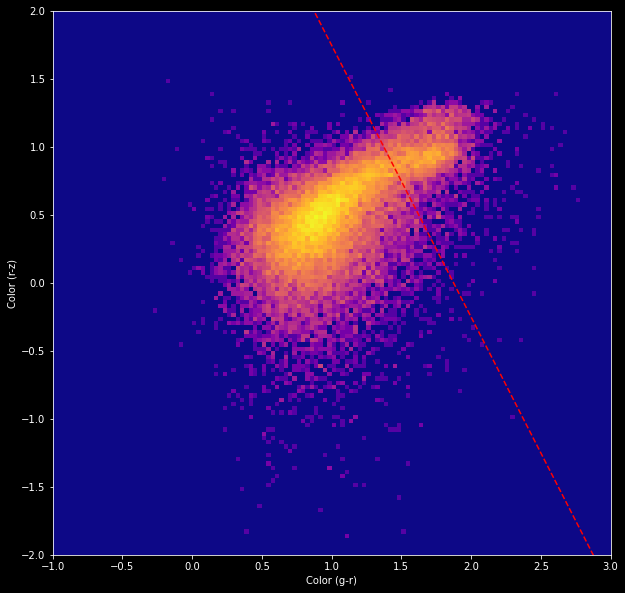

In [6]:
# Red galaxy cut line
grcut = (1.25, 1.75)
rzcut = (1.25, 0.25)
slope = (rzcut[-1] - rzcut[0])/(grcut[-1] - grcut[0])
intercept = rzcut[-1] - slope * grcut[-1]
xcut = (0, 3)
ycut = (intercept, 3 * slope + intercept)

# Make color plot
plt.style.use('dark_background')
plt.figure(figsize=(10,10))
plt.hist2d(x=zbinnedDES['MAG_AUTO_G']-zbinnedDES['MAG_AUTO_R'], y=zbinnedDES['MAG_AUTO_R']-zbinnedDES['MAG_AUTO_Z'], range=((-1, 3), (-2, 2)), bins=128, norm=colors.LogNorm(), cmap=cmap)
plt.plot(xcut, ycut, color='red', linestyle='--')
plt.xlabel('Color (g-r)')
plt.ylabel('Color (r-z)')
plt.show()

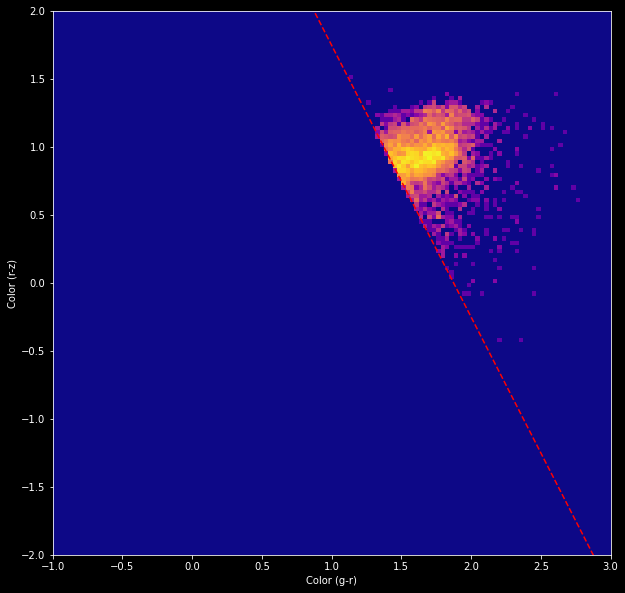

In [7]:
# Apply the cut
redcutDES = zbinnedDES[(zbinnedDES['MAG_AUTO_R'] - zbinnedDES['MAG_AUTO_Z']) - (zbinnedDES['MAG_AUTO_G']-zbinnedDES['MAG_AUTO_R']) * slope > intercept]

# Make color plot
plt.style.use('dark_background')
plt.figure(figsize=(10,10))
plt.hist2d(x=redcutDES['MAG_AUTO_G']-redcutDES['MAG_AUTO_R'], y=redcutDES['MAG_AUTO_R']-redcutDES['MAG_AUTO_Z'], range=((-1, 3), (-2, 2)), bins=128, norm=colors.LogNorm(), cmap=cmap)
plt.plot(xcut, ycut, color='red', linestyle='--')
plt.xlabel('Color (g-r)')
plt.ylabel('Color (r-z)')
plt.show()

In [8]:
# Define some appropriate function that returns a weight of an object based on its grz magnitude
# Here a simple weight based only on r magnitude is applied
def magweightDES(g, r, z):
    return(np.maximum(3.25 - 0.125 * r, 0))

# Record coords in SkyCoord format
coordsDES = SkyCoord(np.array(redcutDES['RA'])*u.deg, np.array(redcutDES['DEC'])*u.deg, frame='fk5')
# Pre-extract grz photometry arrays
gsDES = np.array(redcutDES['MAG_AUTO_G'])
rsDES = np.array(redcutDES['MAG_AUTO_R'])
zsDES = np.array(redcutDES['MAG_AUTO_Z'])
# Loop on all coords to obtain index, unweighted and weighted total arrays
pixelsDES, indicesDES, unweightedDES = np.unique(hp.ang2pix(nside, coordsDES.ra.deg, coordsDES.dec.deg, lonlat=True), return_inverse=True, return_counts=True)
weightedDES = np.zeros_like(unweightedDES, dtype='float')
for i in range(len(pixelsDES)):
    weightedDES[i] = np.sum(magweightDES(gsDES[indicesDES==i], rsDES[indicesDES==i], zsDES[indicesDES==i]))

In [9]:
# Processing preparation
sequenceDES = np.arange(0, len(pixelsDES)-1)
convolvedDES = np.zeros((len(pixelsDES)))
diffDES = np.zeros((len(pixelsDES)))

neighborweight = 0.25
peakcut = 0.75
minpeak = 1

# Passes a custom 3x3 kernel on each pixel with detected objects
print("First pass 3x3 kernel:")
for i in range(len(sequenceDES)):
    neighbors = hp.get_all_neighbours(nside, pixelsDES[i])
    neighborsindex = np.take(sequenceDES, np.searchsorted(pixelsDES, neighbors), mode="clip")
    convolvedDES[i] = np.sum(np.ma.filled(np.ma.array(weightedDES[neighborsindex], mask=(pixelsDES[neighborsindex]!=neighbors)), 0) * (1, 1, 1, 1, 1, 1, 1, 1)) * neighborweight + weightedDES[i]
    if (i % 10000 == 0): print(i, "/", len(sequenceDES))

# Compare convolved value with all of its neighbors
print("Second pass neighbor diff:")
for i in range(len(sequenceDES)):
    neighbors = hp.get_all_neighbours(nside, pixelsDES[i])
    neighborsindex = np.take(sequenceDES, np.searchsorted(pixelsDES, neighbors), mode="clip")
    diffDES[i] = convolvedDES[i] - (np.ma.filled(np.ma.array(convolvedDES[neighborsindex], mask=(pixelsDES[neighborsindex]!=neighbors)), 0)).max()
    if (i % 10000 == 0): print(i, "/", len(sequenceDES))

maskDES = (diffDES > peakcut) & (convolvedDES > minpeak)
peakspixelDES = pixelsDES[maskDES]
peaksrichnessDES = convolvedDES[maskDES]
print(len(peakspixelDES), "peaks located")


First pass 3x3 kernel:
0 / 4579
Second pass neighbor diff:
0 / 4579
143 peaks located


Text(0, 0.5, 'Number of pixels')

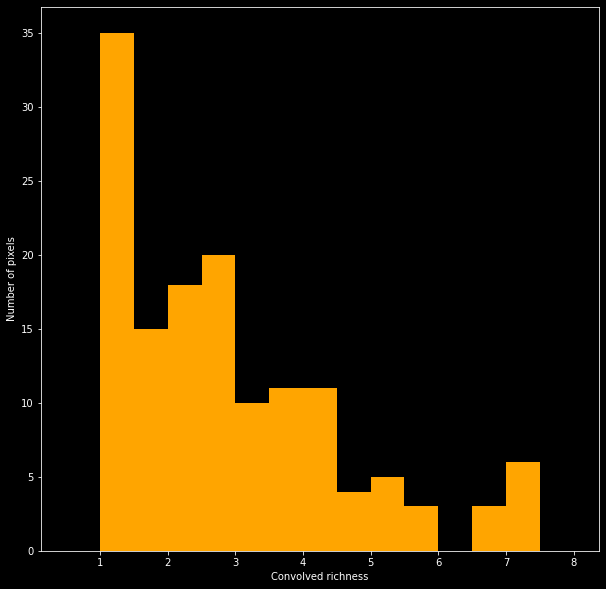

In [10]:
# Plot richness diagram
plt.figure(figsize=(10,10))
plt.hist(peaksrichnessDES, range=(0.5,8.5), bins=np.arange(0.5,8.5,0.5), color='orange')
plt.xlabel('Convolved richness')
plt.ylabel('Number of pixels')

https://www.legacysurvey.org/viewer?ra=69.280068&dec=-54.236309&layer=ls-dr10&zoom=15


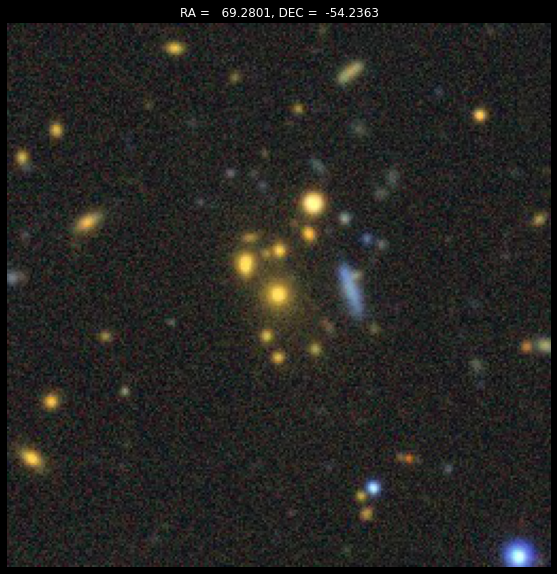

https://www.legacysurvey.org/viewer?ra=69.565031&dec=-54.325083&layer=ls-dr10&zoom=15


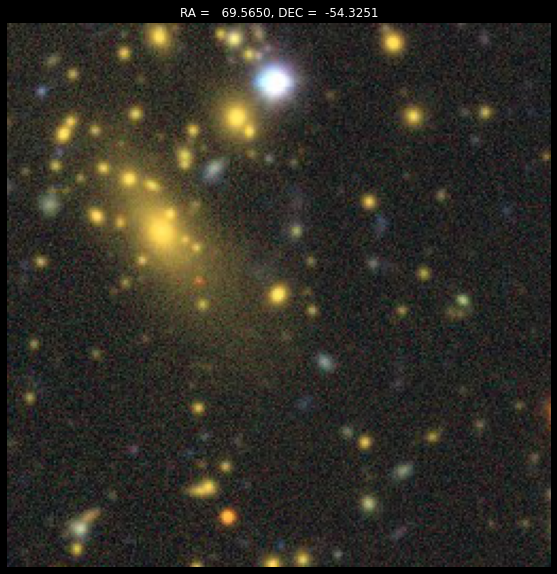

https://www.legacysurvey.org/viewer?ra=70.74108&dec=-54.339593&layer=ls-dr10&zoom=15


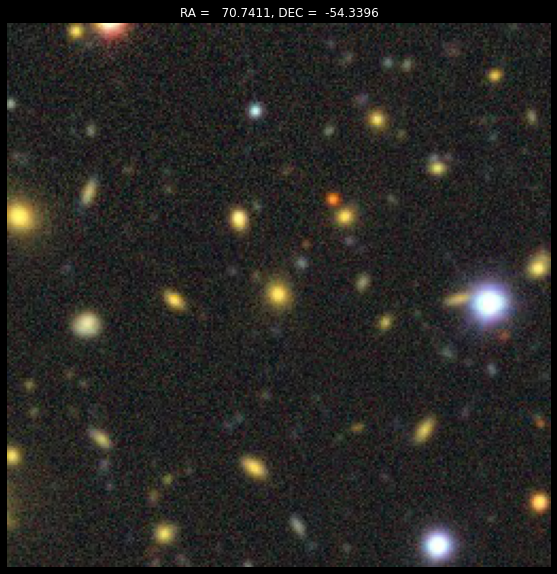

https://www.legacysurvey.org/viewer?ra=70.710931&dec=-54.457655&layer=ls-dr10&zoom=15


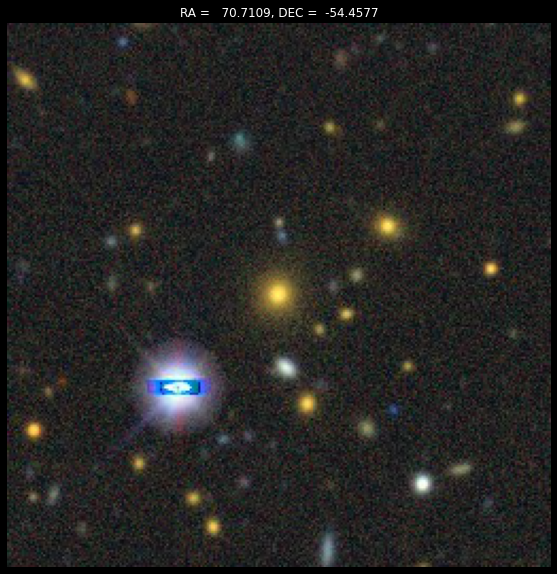

https://www.legacysurvey.org/viewer?ra=69.597676&dec=-54.506211&layer=ls-dr10&zoom=15


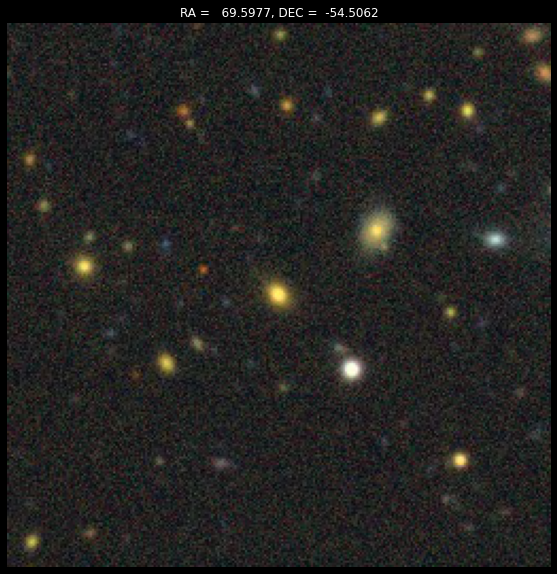

https://www.legacysurvey.org/viewer?ra=69.882542&dec=-54.521457&layer=ls-dr10&zoom=15


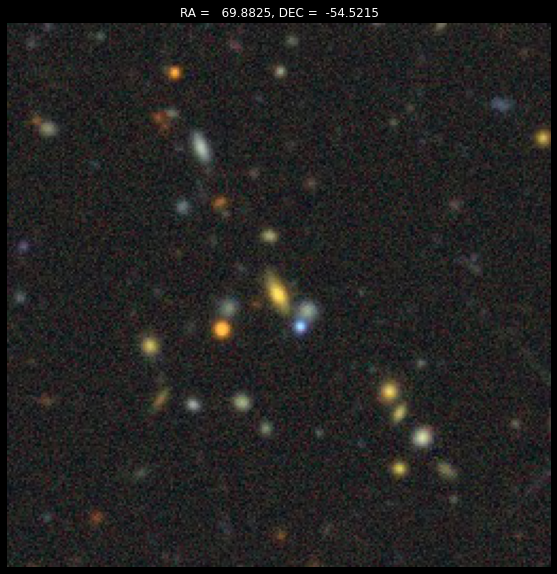

https://www.legacysurvey.org/viewer?ra=69.884899&dec=-54.607978&layer=ls-dr10&zoom=15


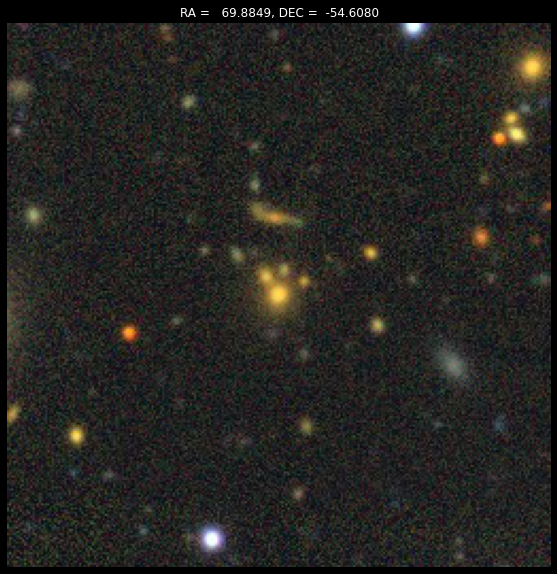

https://www.legacysurvey.org/viewer?ra=69.352752&dec=-54.620736&layer=ls-dr10&zoom=15


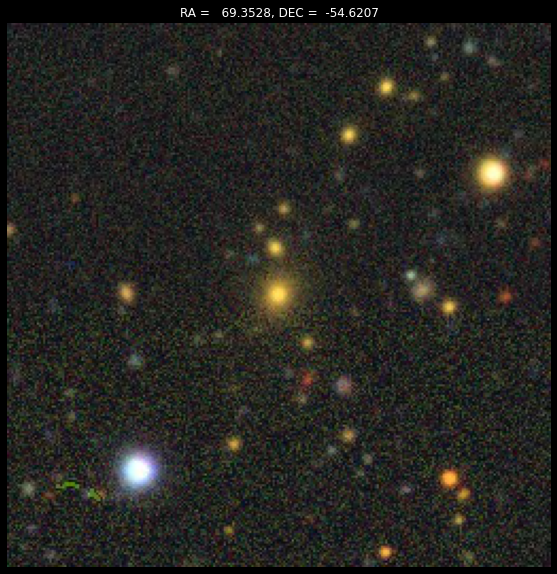

https://www.legacysurvey.org/viewer?ra=70.964481&dec=-54.696045&layer=ls-dr10&zoom=15


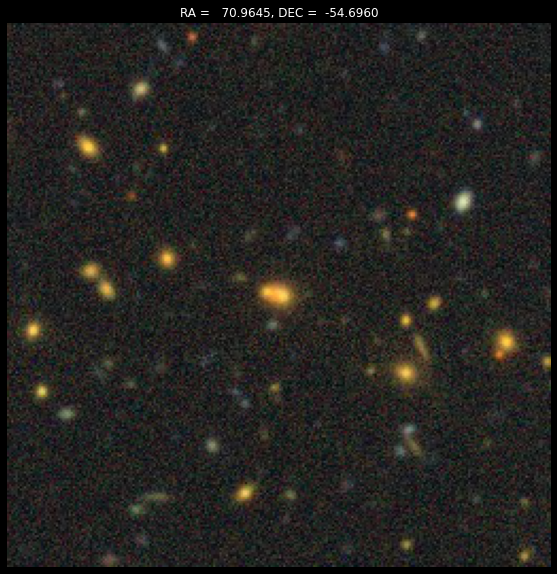

https://www.legacysurvey.org/viewer?ra=69.994934&dec=-54.734808&layer=ls-dr10&zoom=15


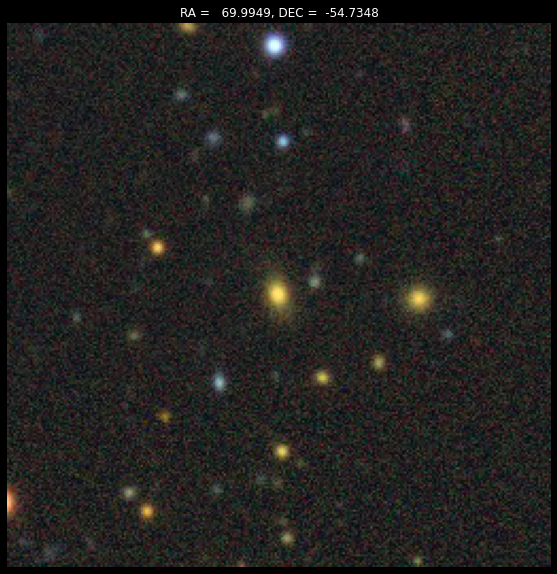

https://www.legacysurvey.org/viewer?ra=70.929046&dec=-54.757209&layer=ls-dr10&zoom=15


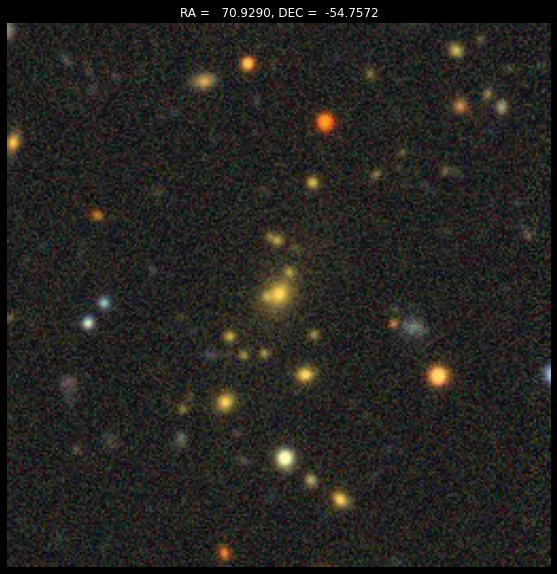

https://www.legacysurvey.org/viewer?ra=70.114737&dec=-55.264993&layer=ls-dr10&zoom=15


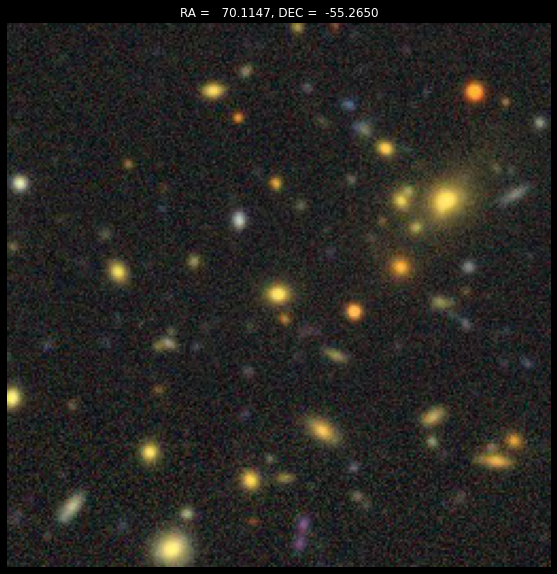

https://www.legacysurvey.org/viewer?ra=70.200733&dec=-55.286102&layer=ls-dr10&zoom=15


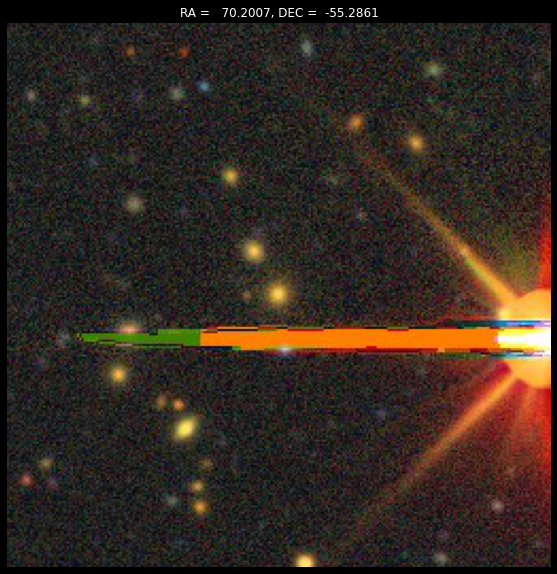

https://www.legacysurvey.org/viewer?ra=70.096016&dec=-55.43834&layer=ls-dr10&zoom=15


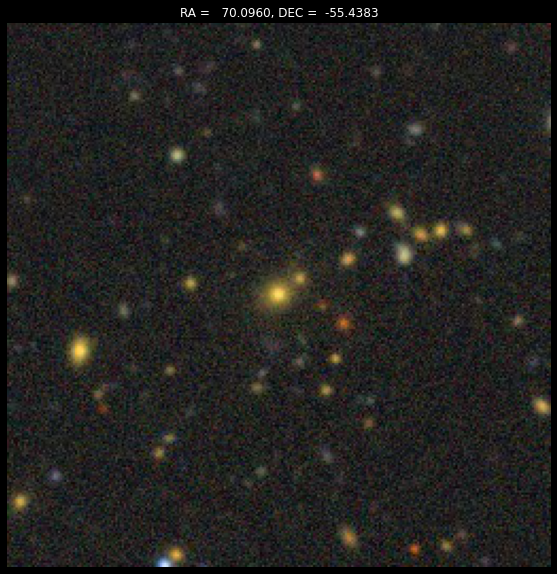

https://www.legacysurvey.org/viewer?ra=70.840751&dec=-55.432143&layer=ls-dr10&zoom=15


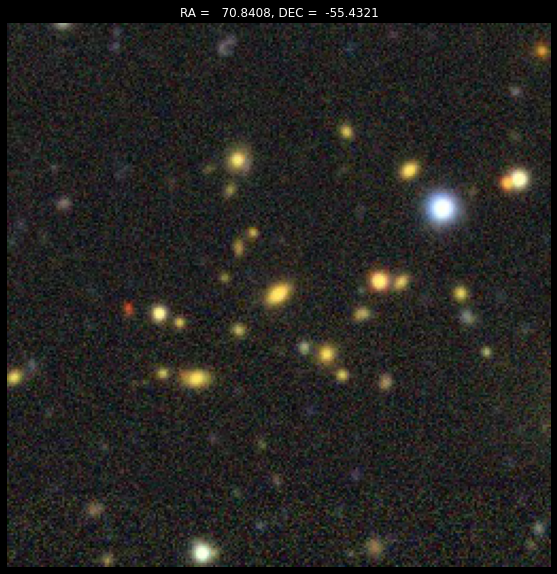

https://www.legacysurvey.org/viewer?ra=71.321507&dec=-55.420967&layer=ls-dr10&zoom=15


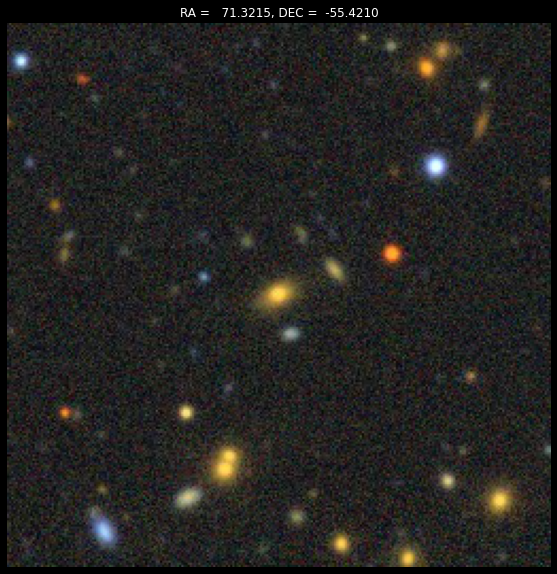

https://www.legacysurvey.org/viewer?ra=70.285698&dec=-55.466308&layer=ls-dr10&zoom=15


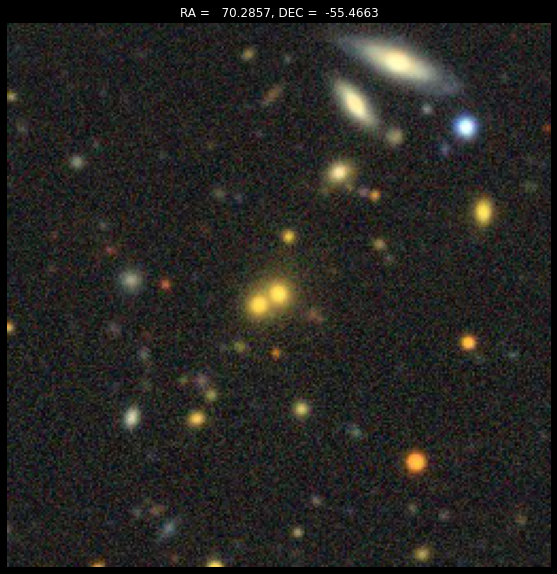

https://www.legacysurvey.org/viewer?ra=69.32257&dec=-55.553158&layer=ls-dr10&zoom=15


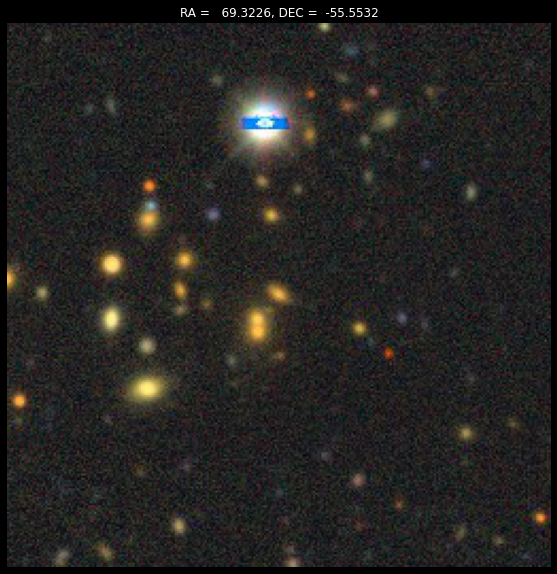

https://www.legacysurvey.org/viewer?ra=69.988474&dec=-55.563225&layer=ls-dr10&zoom=15


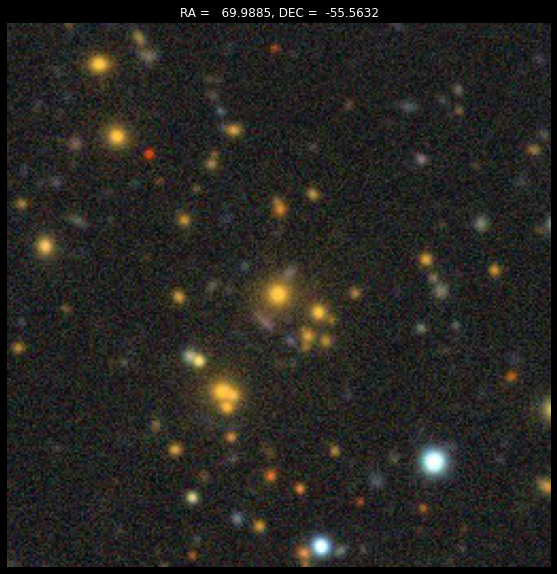

19 candidates found!


In [11]:
# Richness threshold
minrichness = 5
maxmagr = 21

# Attempt detection of candidate BCG
selectedpixelsDES = peakspixelDES[peaksrichnessDES > minrichness]
selectedvaluesDES = peaksrichnessDES[peaksrichnessDES > minrichness]
selectedcoordsDES = SkyCoord(hp.pix2ang(nside, selectedpixelsDES, lonlat=True)[0]*u.deg, hp.pix2ang(nside, selectedpixelsDES, lonlat=True)[1]*u.deg, frame='fk5')
candidatesDES = []
for c in selectedcoordsDES:
    nearreds = redcutDES[coordsDES.separation(c).arcmin < resol]
    potbcg = nearreds.loc[nearreds['MAG_AUTO_R'].idxmin()]
    if (potbcg['MAG_AUTO_R'] < maxmagr):
        candidatesDES.append((potbcg['RA'], potbcg['DEC']))
        # make cutout images
        cutoutra = potbcg['RA']
        cutoutdec = potbcg['DEC']
        print("https://www.legacysurvey.org/viewer?ra="+(str)(cutoutra)+"&dec="+(str)(cutoutdec)+"&layer=ls-dr10&zoom=15")
        response = requests.get("https://www.legacysurvey.org/viewer/cutout.jpg?ra="+(str)(cutoutra)+"&dec="+(str)(cutoutdec)+"&layer=ls-dr10&pixscale=0.33")
        content_type = response.headers["Content-Type"]
        image = Image.open(io.BytesIO(response.content))
        plt.style.use('dark_background')
        plt.figure(figsize=(10,10))
        plt.title("RA ="+"{:10.4f}".format(cutoutra)+", DEC ="+"{:10.4f}".format(cutoutdec))
        plt.axis('off')
        plt.imshow(image)
        plt.show()
print('{:d} candidates found!'.format(len(candidatesDES)))

In [12]:
# Run the LS query
# Also including PSFs in case of future analysis

fullLS = qc.query(sql=queryLS, fmt='pandas')
fullLS.columns = fullLS.columns.str.upper()
print(fullLS)
galsLS = fullLS[fullLS['TYPE'].isin(['REX', 'SER', 'DUP'])]
print(galsLS)

               RA        DEC  DERED_MAG_G  DERED_MAG_R  DERED_MAG_Z TYPE
0       71.355182 -55.635776    23.659712    23.632935    22.900013  REX
1       71.362954 -55.625754    22.757008    22.460848    21.830719  DEV
2       71.351346 -55.631954    24.735634    24.282675    23.626146  PSF
3       71.353586 -55.630175    21.652030    20.142181    18.863646  PSF
4       71.348921 -55.629795    25.275870    25.098324    23.967136  REX
...           ...        ...          ...          ...          ...  ...
432745  68.991355 -54.243990    25.150960    24.545920    23.790962  PSF
432746  68.989168 -54.243876    18.889720    18.501652    18.382420  PSF
432747  68.998281 -54.241773    24.153133    23.516237    22.780756  EXP
432748  68.997271 -54.240042    24.233738    23.662205    22.838133  REX
432749  68.993510 -54.241292    23.013891    22.544760    21.749096  REX

[432750 rows x 6 columns]
               RA        DEC  DERED_MAG_G  DERED_MAG_R  DERED_MAG_Z TYPE
0       71.355182 -55.63

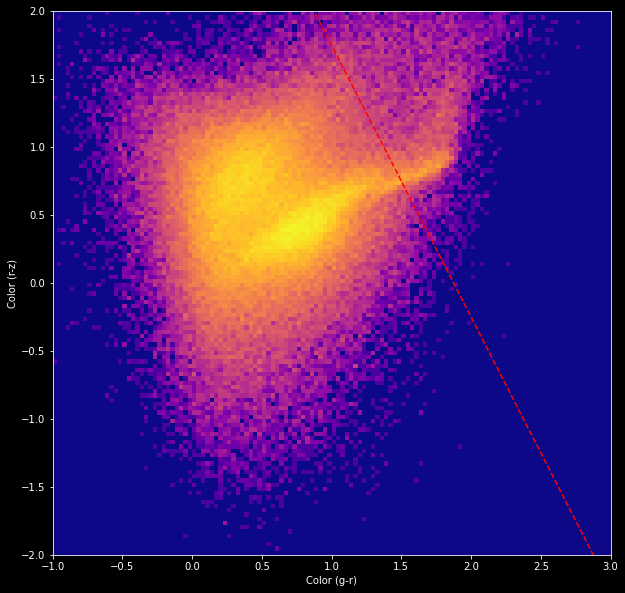

In [13]:
# Red galaxy cut line
# No z cut on LS as it is shallower than DES, using the same cut as for DES
grcut = (1.25, 1.75)
rzcut = (1.25, 0.25)
slope = (rzcut[-1] - rzcut[0])/(grcut[-1] - grcut[0])
intercept = rzcut[-1] - slope * grcut[-1]
xcut = (0, 3)
ycut = (intercept, 3 * slope + intercept)

# Make color plot
plt.style.use('dark_background')
plt.figure(figsize=(10,10))
plt.hist2d(x=galsLS['DERED_MAG_G']-galsLS['DERED_MAG_R'], y=galsLS['DERED_MAG_R']-galsLS['DERED_MAG_Z'], range=((-1, 3), (-2, 2)), bins=128, norm=colors.LogNorm(), cmap=cmap)
plt.plot(xcut, ycut, color='red', linestyle='--')
plt.xlabel('Color (g-r)')
plt.ylabel('Color (r-z)')
plt.show()

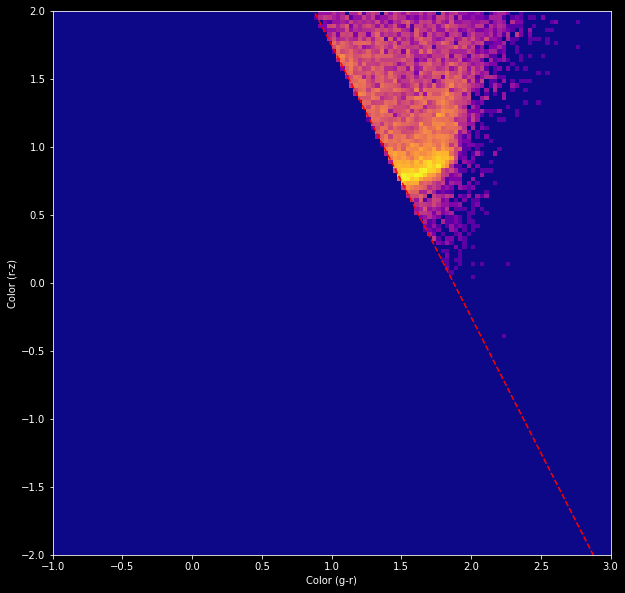

In [14]:
# Apply the cut
redcutLS = galsLS[(galsLS['DERED_MAG_R'] - galsLS['DERED_MAG_Z']) - (galsLS['DERED_MAG_G']-galsLS['DERED_MAG_R']) * slope > intercept]

# Make color plot
plt.style.use('dark_background')
plt.figure(figsize=(10,10))
plt.hist2d(x=redcutLS['DERED_MAG_G']-redcutLS['DERED_MAG_R'], y=redcutLS['DERED_MAG_R']-redcutLS['DERED_MAG_Z'], range=((-1, 3), (-2, 2)), bins=128, norm=colors.LogNorm(), cmap=cmap)
plt.plot(xcut, ycut, color='red', linestyle='--')
plt.xlabel('Color (g-r)')
plt.ylabel('Color (r-z)')
plt.show()

In [15]:
# Define some appropriate function that returns a weight of an object based on its grz magnitude
# Here a simple weight based only on r magnitude is applied
def magweightLS(g, r, z):
    return(np.maximum(3.25 - 0.125 * r, 0))

# Record coords in SkyCoord format
coordsLS = SkyCoord(np.array(redcutLS['RA'])*u.deg, np.array(redcutLS['DEC'])*u.deg, frame='fk5')
# Pre-extract grz photometry arrays
gsLS = np.array(redcutLS['DERED_MAG_G'])
rsLS = np.array(redcutLS['DERED_MAG_R'])
zsLS = np.array(redcutLS['DERED_MAG_Z'])
# Loop on all coords to obtain index, unweighted and weighted total arrays
pixelsLS, indicesLS, unweightedLS = np.unique(hp.ang2pix(nside, coordsLS.ra.deg, coordsLS.dec.deg, lonlat=True), return_inverse=True, return_counts=True)
weightedLS = np.zeros_like(unweightedLS, dtype='float')
for i in range(len(pixelsLS)):
    weightedLS[i] = np.sum(magweightLS(gsLS[indicesLS==i], rsLS[indicesLS==i], zsLS[indicesLS==i]))

In [16]:
# Processing Preparation
sequenceLS = np.arange(0, len(pixelsLS)-1)
convolvedLS = np.zeros((len(pixelsLS)))
diffLS = np.zeros((len(pixelsLS)))

# Configuration
neighborweight = 0.25
peakcut = 0.75
minpeak = 1

# Passes a custom 3x3 kernel on each pixel with detected objects
print("First pass 3x3 kernel:")
for i in range(len(sequenceLS)):
    neighbors = hp.get_all_neighbours(nside, pixelsLS[i])
    neighborsindex = np.take(sequenceLS, np.searchsorted(pixelsLS, neighbors), mode="clip")
    convolvedLS[i] = np.sum(np.ma.filled(np.ma.array(weightedLS[neighborsindex], mask=(pixelsLS[neighborsindex]!=neighbors)), 0) * (1, 1, 1, 1, 1, 1, 1, 1)) * neighborweight + weightedLS[i]
    if (i % 10000 == 0): print(i, "/", len(sequenceLS))

# Compare convolved value with all of its neighbors
print("Second pass neighbor diff:")
for i in range(len(sequenceLS)):
    neighbors = hp.get_all_neighbours(nside, pixelsLS[i])
    neighborsindex = np.take(sequenceLS, np.searchsorted(pixelsLS, neighbors), mode="clip")
    diffLS[i] = convolvedLS[i] - (np.ma.filled(np.ma.array(convolvedLS[neighborsindex], mask=(pixelsLS[neighborsindex]!=neighbors)), 0)).max()
    if (i % 10000 == 0): print(i, "/", len(sequenceLS))

maskLS = (diffLS > peakcut) & (convolvedLS > minpeak)
peakspixelLS = pixelsLS[maskLS]
peaksrichnessLS = convolvedLS[maskLS]
print(len(peakspixelLS), "peaks located")


First pass 3x3 kernel:
0 / 9190
Second pass neighbor diff:
0 / 9190
115 peaks located


Text(0, 0.5, 'Number of pixels')

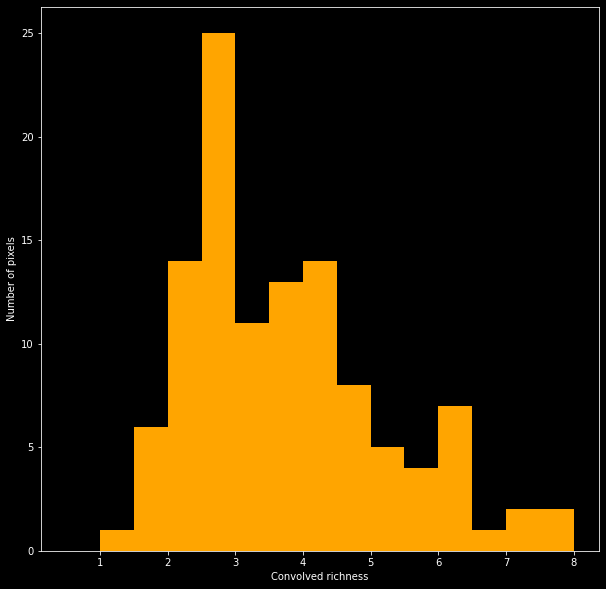

In [17]:
# Plot richness diagram
plt.figure(figsize=(10,10))
plt.hist(peaksrichnessLS, range=(0.5,8.5), bins=np.arange(0.5,8.5,0.5), color='orange')
plt.xlabel('Convolved richness')
plt.ylabel('Number of pixels')

https://www.legacysurvey.org/viewer?ra=69.28011558317287&dec=-54.23628896780036&layer=ls-dr10&zoom=15


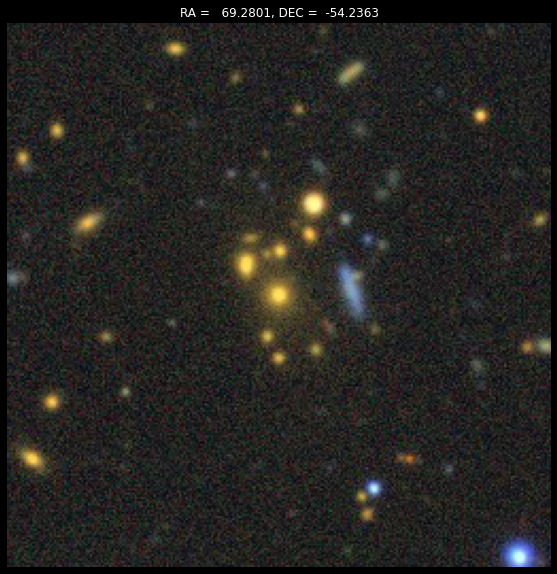

https://www.legacysurvey.org/viewer?ra=69.57368626643921&dec=-54.32233146679877&layer=ls-dr10&zoom=15


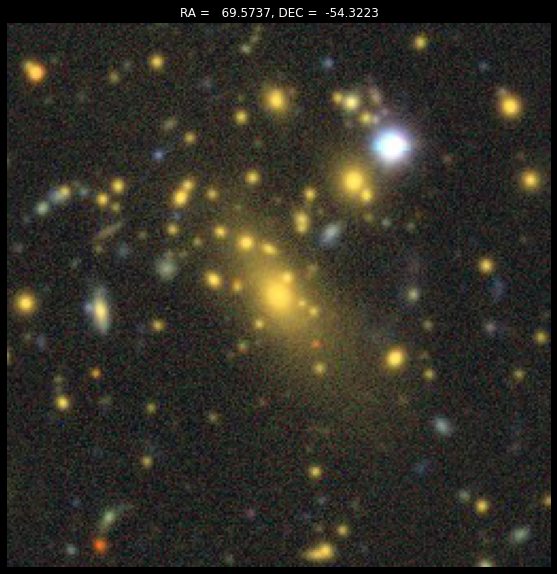

https://www.legacysurvey.org/viewer?ra=70.71043147041864&dec=-54.39163145520372&layer=ls-dr10&zoom=15


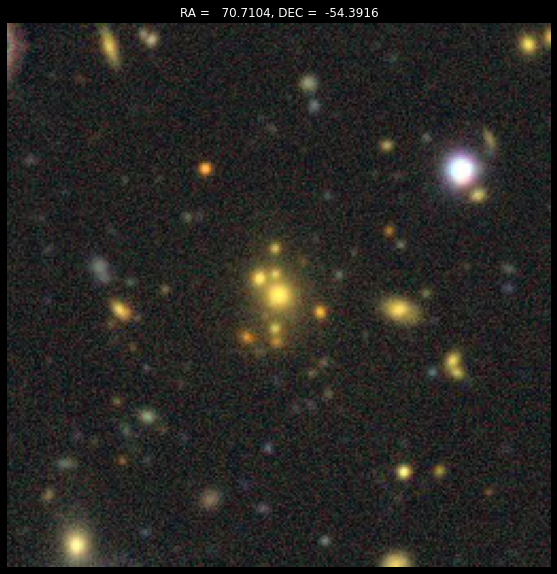

https://www.legacysurvey.org/viewer?ra=69.9166155238449&dec=-54.403826724078606&layer=ls-dr10&zoom=15


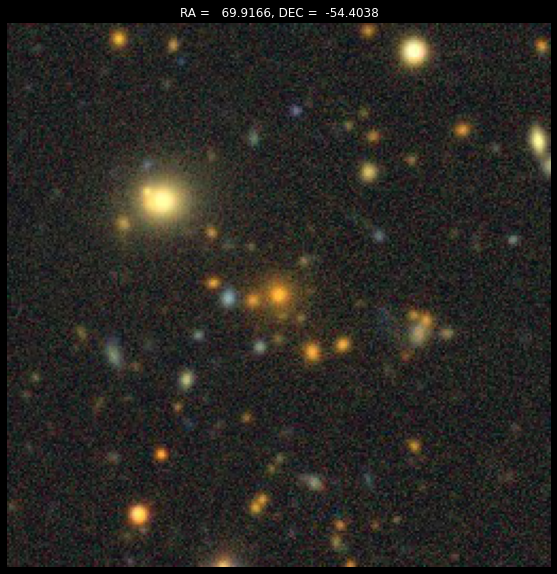

https://www.legacysurvey.org/viewer?ra=70.33347103926546&dec=-54.41652169218033&layer=ls-dr10&zoom=15


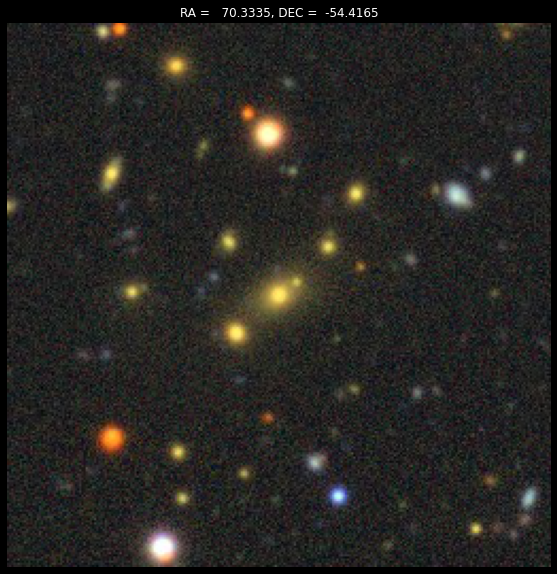

https://www.legacysurvey.org/viewer?ra=69.01053033315526&dec=-54.46544359866824&layer=ls-dr10&zoom=15


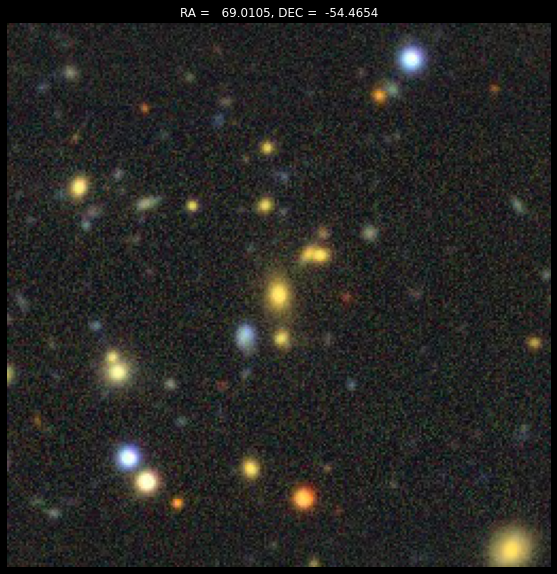

https://www.legacysurvey.org/viewer?ra=70.71098077628115&dec=-54.4576301735206&layer=ls-dr10&zoom=15


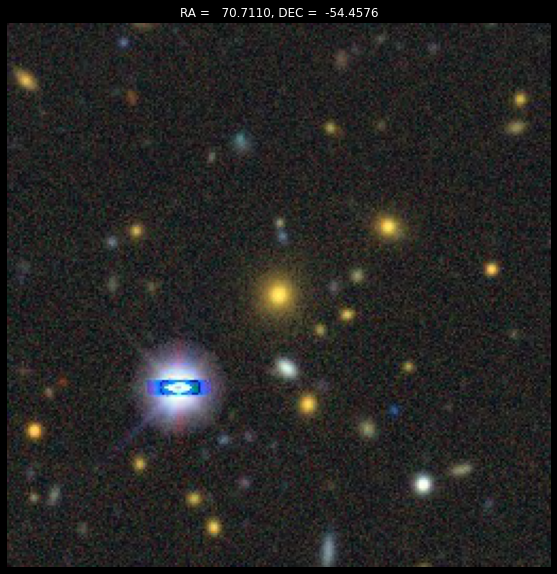

https://www.legacysurvey.org/viewer?ra=70.16042956486866&dec=-54.57302107216942&layer=ls-dr10&zoom=15


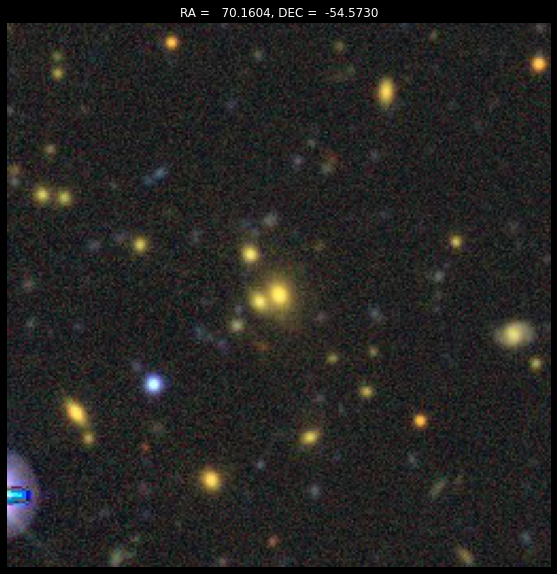

https://www.legacysurvey.org/viewer?ra=69.91412056412679&dec=-54.72538949969261&layer=ls-dr10&zoom=15


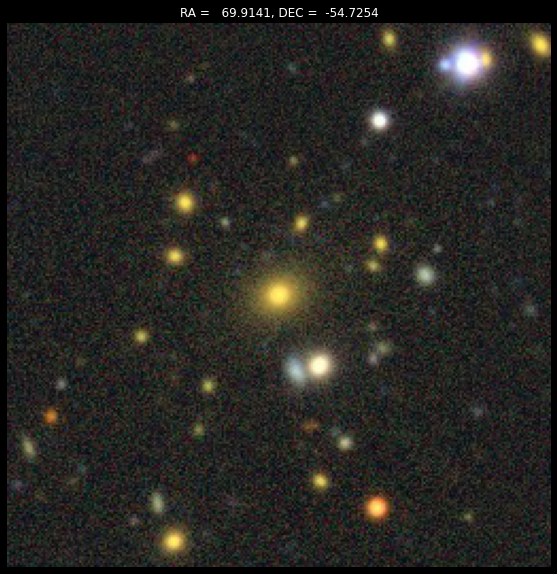

https://www.legacysurvey.org/viewer?ra=71.25368790612242&dec=-54.72350632282293&layer=ls-dr10&zoom=15


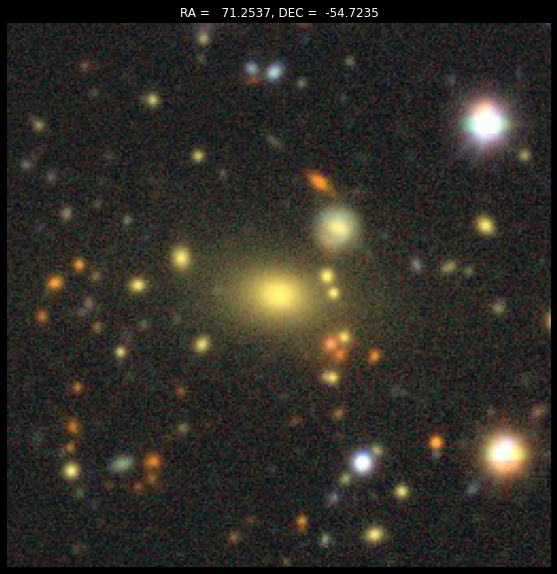

https://www.legacysurvey.org/viewer?ra=70.26880630853262&dec=-54.742563058680645&layer=ls-dr10&zoom=15


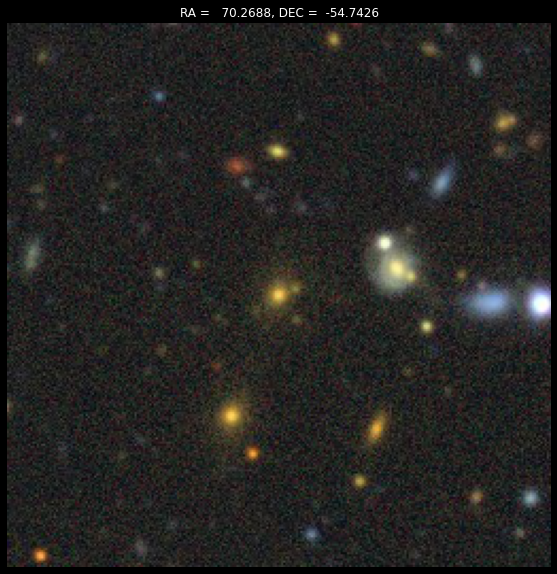

https://www.legacysurvey.org/viewer?ra=68.46720303860458&dec=-54.76109968055006&layer=ls-dr10&zoom=15


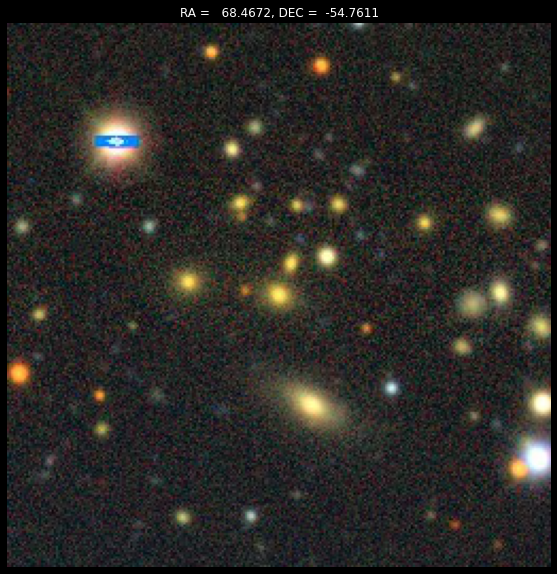

https://www.legacysurvey.org/viewer?ra=71.41457166121052&dec=-54.87370263585097&layer=ls-dr10&zoom=15


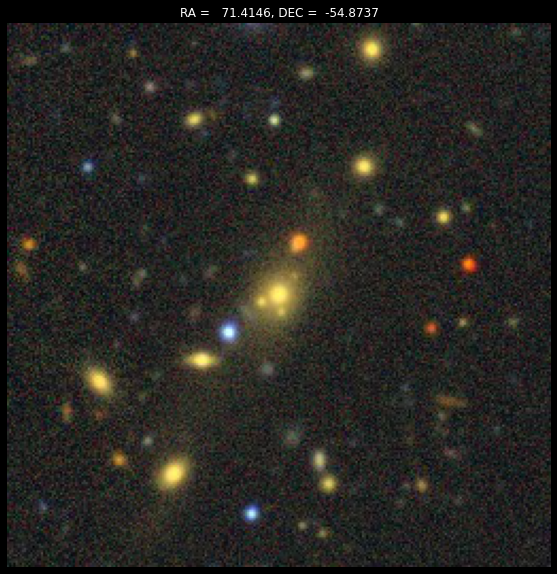

https://www.legacysurvey.org/viewer?ra=69.59076935885089&dec=-55.01753642956171&layer=ls-dr10&zoom=15


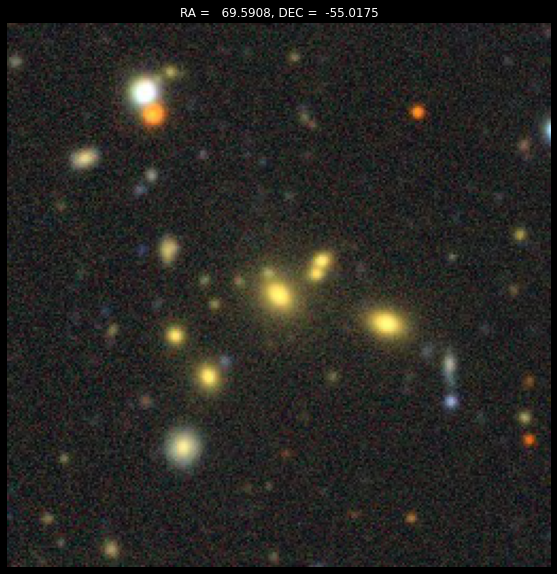

https://www.legacysurvey.org/viewer?ra=70.21800201367768&dec=-55.02817882695587&layer=ls-dr10&zoom=15


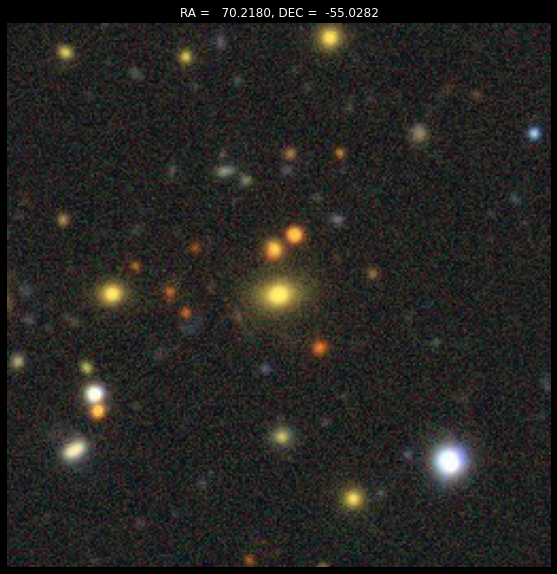

https://www.legacysurvey.org/viewer?ra=70.10207592216496&dec=-55.2609227811356&layer=ls-dr10&zoom=15


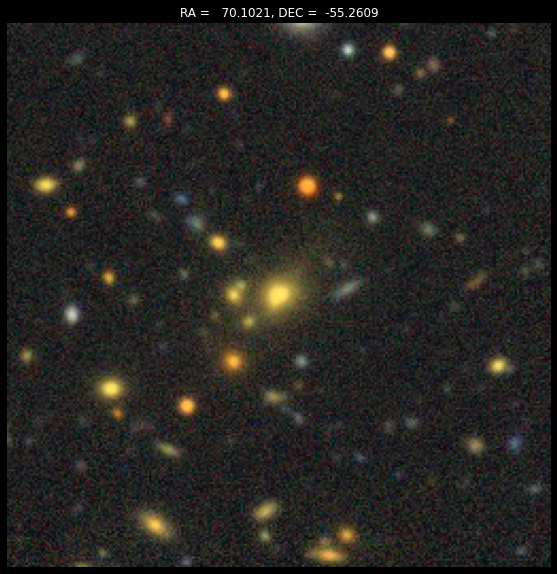

https://www.legacysurvey.org/viewer?ra=70.09605848584562&dec=-55.43831141923732&layer=ls-dr10&zoom=15


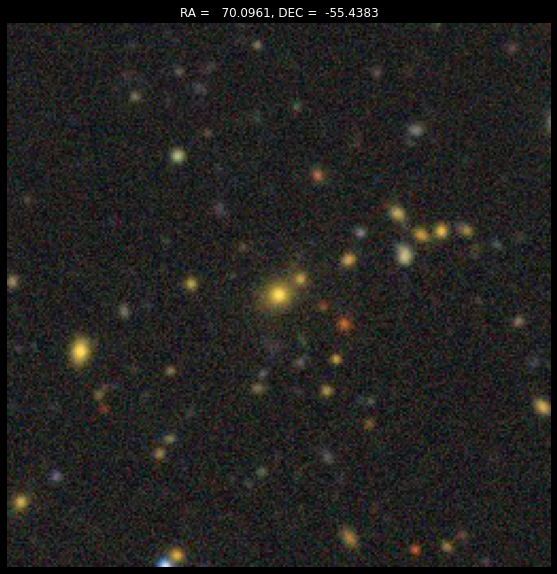

https://www.legacysurvey.org/viewer?ra=69.98852703501441&dec=-55.56319440620887&layer=ls-dr10&zoom=15


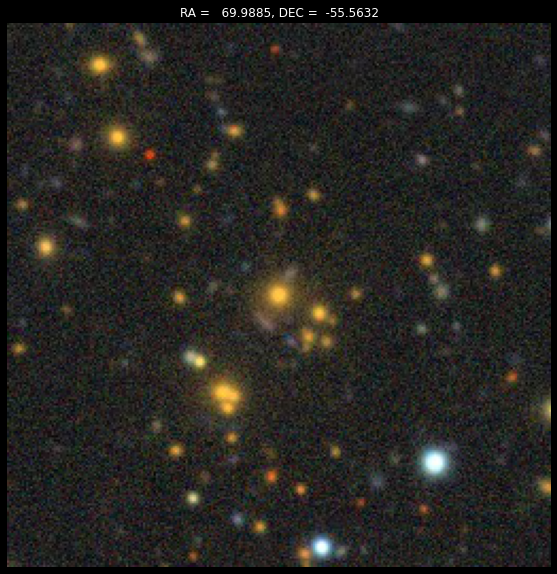

https://www.legacysurvey.org/viewer?ra=69.48414752661645&dec=-55.7559996346973&layer=ls-dr10&zoom=15


In [ ]:
# Richness threshold
minrichness = 5
maxmagr = 20

# Attempt detection of candidate BCG
selectedpixelsLS = peakspixelLS[peaksrichnessLS > minrichness]
selectedvaluesLS = peaksrichnessLS[peaksrichnessLS > minrichness]
selectedcoordsLS = SkyCoord(hp.pix2ang(nside, selectedpixelsLS, lonlat=True)[0]*u.deg, hp.pix2ang(nside, selectedpixelsLS, lonlat=True)[1]*u.deg, frame='fk5')
candidatesLS = []
for c in selectedcoordsLS:
    nearreds = redcutLS[coordsLS.separation(c).arcmin < resol]
    potbcg = nearreds.loc[nearreds['DERED_MAG_R'].idxmin()]
    if (potbcg['DERED_MAG_R'] < maxmagr):
        candidatesLS.append((potbcg['RA'], potbcg['DEC']))
        # make cutout images
        cutoutra = potbcg['RA']
        cutoutdec = potbcg['DEC']
        print("https://www.legacysurvey.org/viewer?ra="+(str)(cutoutra)+"&dec="+(str)(cutoutdec)+"&layer=ls-dr10&zoom=15")
        response = requests.get("https://www.legacysurvey.org/viewer/cutout.jpg?ra="+(str)(cutoutra)+"&dec="+(str)(cutoutdec)+"&layer=ls-dr10&pixscale=0.33")
        content_type = response.headers["Content-Type"]
        image = Image.open(io.BytesIO(response.content))
        plt.style.use('dark_background')
        plt.figure(figsize=(10,10))
        plt.title("RA ="+"{:10.4f}".format(cutoutra)+", DEC ="+"{:10.4f}".format(cutoutdec))
        plt.axis('off')
        plt.imshow(image)
        plt.show()
print('{:d} candidates found!'.format(len(candidatesLS)))

<a class="anchor" id="comp"></a>
# Matching between two results and Redmapper catalog

In [ ]:
redmapper = qc.query(sql=queryRedmapper, fmt='pandas')
redmapper.columns = redmapper.columns.str.upper()
plt.figure(figsize=(10,10))
plt.scatter(np.transpose(candidatesDES)[0], np.transpose(candidatesDES)[1], c='yellow', s=144, marker='+', label='DES results')
plt.scatter(np.transpose(candidatesLS)[0], np.transpose(candidatesLS)[1], c='g', s=144, marker='x', label='LS results')
plt.scatter(np.array(redmapper['RA_J2000']), np.array(redmapper['DEC_J2000']), s=144, marker='o', facecolors='none', edgecolors='r', linewidth=1, label='Redmapper clusters')
plt.xlabel('RA(degrees)')
plt.ylabel('DEC(degrees)')
plt.legend()

<a class="anchor" id="resources"></a>
# Resources and references
Rykoff, E. S. (2014) "redMaPPer. I. Algorithm and SDSS DR8 Catalog". The Astrophysical Journal, Volume 785, Issue 2, article id. 104, 33 pp.: https://adsabs.harvard.edu/abs/2014ApJ...785..104R

Sevilla-Noarbe, I. (2021) "Dark Energy Survey Year 3 Results: Photometric Data Set for Cosmology". The Astrophysical Journal Supplement Series, Volume 254, Issue 2, id.24, 34 pp.: https://arxiv.org/abs/2011.03407

Legacy Survey DR10: https://www.legacysurvey.org/dr10/description/

Python packages:

astropy: https://docs.astropy.org/en/stable/index.html

numpy: https://numpy.org/doc/stable/

pandas: https://pandas.pydata.org/docs/

healpy: https://healpy.readthedocs.io/en/latest/

matplotlib: https://matplotlib.org/stable/api/index/

requests: https://requests.readthedocs.io/en/latest/

PIL: https://pillow.readthedocs.io/en/stable/